In [1]:
import os
import sys
import random
import time
from random import seed, randint
import argparse
import platform
from datetime import datetime
import imp
import numpy as np
import fileinput
from itertools import product
import pandas as pd
from scipy.interpolate import griddata
from scipy.interpolate import interp2d
import seaborn as sns
from os import listdir

import matplotlib.pyplot as plt
import seaborn as sns
from scipy.interpolate import griddata
import matplotlib as mpl
# sys.path.insert(0,'..')
# from notebookFunctions import *
# from .. import notebookFunctions
import plotly.express as px
from Bio.PDB.PDBParser import PDBParser
from pyCodeLib import *
%matplotlib inline
# plt.rcParams['figure.figsize'] = (10,6.180)    #golden ratio
# %matplotlib notebook
%load_ext autoreload
%autoreload 2

In [2]:
plt.rcParams['figure.figsize'] = [16.18033, 10]    #golden ratio
plt.rcParams['figure.facecolor'] = 'w'
plt.rcParams['figure.dpi'] = 100

In [3]:
data = pd.read_csv("/Users/weilu/Research/data/survey_represent_x_com_complete.csv", index_col=0)

In [4]:
res_type_list = ['GLY', 'ALA', 'VAL', 'CYS', 'PRO', 'LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']

In [6]:
import plotly.express as px

In [17]:
import pickle
with open('/Users/weilu/Research/server/feb_2020/SPOT-Contact-Helical-New/dat/norm_data.p','rb') as f:
    [normmu_1D,normmu_2D,normstd_1D,normstd_2D] = pickle.load(f, encoding='bytes')

In [22]:
normstd_2D

array([0.14335388, 0.04150532, 0.12558651])

In [12]:
normmu_1D

array([-1.13778871e+00, -1.75183976e+00, -1.88778460e+00, -2.00458707e+00,
       -3.06235861e+00, -1.53430763e+00, -1.59194929e+00, -2.49413793e+00,
       -1.91433943e+00, -1.88810931e+00, -1.87495150e+00, -1.68545308e+00,
       -1.71195777e+00, -2.47803716e+00, -2.74514083e+00, -1.35875291e+00,
       -1.32537995e+00, -3.54856782e+00, -2.30080381e+00, -1.61379622e+00,
        4.66334163e+03,  7.75981905e+03,  5.82798800e+03,  5.46451430e+03,
        6.32947547e+03,  5.72507194e+03,  6.76221872e+03,  5.52314905e+03,
        5.64170106e+03,  4.77894950e+03,  6.81250159e+03,  5.94851263e+03,
        6.62919137e+03,  5.97855564e+03,  5.64161426e+03,  4.98262473e+03,
        5.25550425e+03,  5.15618009e+03,  8.19335663e+03,  6.62332660e+03,
        7.19192602e+01,  7.66099011e+03,  7.83401544e+03,  4.56166831e+03,
        4.79922818e+03,  4.70480925e+03,  3.18147632e+03,  8.31713225e+03,
        9.01278337e+02,  1.50942671e+03,  4.32863513e-02, -2.37969590e-01,
       -1.42659475e-01, -

In [13]:
normmu_2D

array([0.19296147, 0.03356267, 0.20597566])

In [14]:
normstd_1D

array([2.65150922e+00, 3.25202199e+00, 3.10466164e+00, 3.58220683e+00,
       2.84541152e+00, 2.90664309e+00, 3.33430912e+00, 3.33800215e+00,
       3.08840057e+00, 3.39332993e+00, 3.28306332e+00, 3.07107903e+00,
       2.85606524e+00, 3.35928861e+00, 3.33926302e+00, 2.60421341e+00,
       2.56093474e+00, 3.26479789e+00, 3.13817961e+00, 3.11712255e+00,
       2.12964412e+03, 1.93841165e+03, 2.63294390e+03, 2.60314805e+03,
       2.38542130e+03, 2.48995313e+03, 2.08015607e+03, 2.39448111e+03,
       2.52923669e+03, 2.40850208e+03, 2.01159107e+03, 2.32501970e+03,
       2.58619329e+03, 2.26067086e+03, 2.45278414e+03, 2.13311461e+03,
       2.07513030e+03, 2.27535707e+03, 1.96773486e+03, 2.29264120e+03,
       1.92989424e+02, 2.41906833e+03, 2.35567267e+03, 4.12220267e+03,
       4.62909916e+03, 4.09334346e+03, 4.20023526e+03, 2.68140836e+03,
       8.90406783e+02, 1.52855941e+03, 4.39040876e-01, 3.99986194e-01,
       3.88591308e-01, 5.40866896e-01, 4.26762694e-01, 5.71969119e-01,
      

In [15]:
normstd_2D

array([0.14335388, 0.04150532, 0.12558651])

In [9]:
import plotly.express as px
res = "PRO"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

PRO (3190, 7)


In [8]:
res = "VAL"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

VAL (5386, 7)


In [196]:
res = "CYS"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

CYS (1043, 7)


In [197]:
res = "PRO"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

PRO (3190, 7)


In [198]:
# res_type_list = ['LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "LEU"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

LEU (9908, 7)


In [212]:
res = "ILE"
data_res = data.query(f"ResName == '{res}'")
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [213]:
# res_type_list = ['LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "MET"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

MET (1558, 7)


In [214]:
# res_type_list = ['LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "TRP"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

TRP (1173, 7)


In [215]:
# res_type_list = ['LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "PHE"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

PHE (3403, 7)


In [216]:
# res_type_list = ['LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "SER"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

SER (5209, 7)


In [217]:
# res_type_list = ['LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "THR"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

THR (4554, 7)


In [218]:
# res_type_list = ['LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "TYR"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

TYR (2733, 7)


In [219]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "GLN"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

GLN (3689, 7)


In [220]:
res = "GLN"
data_res = data.query(f"ResName == '{res}'")
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [222]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "ASN"
data_res = data.query(f"ResName == '{res}'")
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [223]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "LYS"
data_res = data.query(f"ResName == '{res}'")
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [224]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "ARG"
data_res = data.query(f"ResName == '{res}'")
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [225]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "HIS"
data_res = data.query(f"ResName == '{res}'")
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [226]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "ASP"
data_res = data.query(f"ResName == '{res}'")
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [227]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "GLU"
data_res = data.query(f"ResName == '{res}'")
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [129]:
gmm_dic = {}
for res in res_type_list[1:]:
    with open(f"/Users/weilu/opt/parameters/side_chain/gmm_{res}.pkl", 'rb') as f:
        gmm = loaded_model = pickle.load(f)
    gmm_dic[res] = gmm

In [184]:
fastaFile = "/Users/weilu/Research/server/feb_2020/compare_side_chain_with_and_without/native/256_cbd_timestep_5_subMode10/crystal_structure.fasta"
moviePDB = "/Users/weilu/Research/server/feb_2020/compare_side_chain_with_and_without/native/256_cbd_timestep_5_subMode10/movie.pdb"
# moviePDB = "/Users/weilu/Research/server/feb_2020/compare_side_chain_with_and_without/setups/256b/cbd-openmmawsem.pdb"
moviePDB = "/Users/weilu/Research/server/feb_2020/compare_side_chain_with_and_without/native/256_cbd_timestep_2_subMode8//movie.pdb"

seq = read_fasta(fastaFile)
parser = PDBParser()
s = parser.get_structure("X", moviePDB)

In [185]:
def get_r1_r2_r3(res):
    r1 = res["N"] - res["CB"]
    r2 = res["CA"] - res["CB"]
    r3 = res["C"] - res["CB"]
    return r1,r2,r3

def dis(a, b):
    return ((a[0]-b[0])**2 + (a[1]-b[1])**2 + (a[2]-b[2])**2)**0.5

In [186]:
info_ = []
for model_i, model in enumerate(s.get_models()):
    for i, res in enumerate(model.get_residues()):
        # print(i, res)
        resname = one_to_three(seq[i])
        if resname == "GLY":
            continue
        if "N" not in res:
            continue
        if "C" not in res:
            continue
        r1,r2,r3 = get_r1_r2_r3(res)
        r = [r1,r2,r3]
        cat = gmm_dic[resname].predict([r])[0]
        score = gmm_dic[resname].score([r])
        info_.append([model_i, i, resname, cat, score, r1, r2, r3])

In [187]:
a = pd.DataFrame(info_, columns=["Model", "i", "ResName", "Category", "Score", "R1", "R2", "R3"])
a["Energy"] = -0.1*a["Score"]

In [189]:
a.groupby("i")["Energy"].sum().sort_values()

i
95    -12.073434
15    -10.540180
5      -9.913892
8      -9.750751
12     -9.734938
68     -9.476498
25     -9.314118
96     -9.248321
4      -8.345915
83     -8.345577
23     -8.335010
13     -8.313357
65     -8.182816
11     -7.870873
49     -7.852410
16     -7.569901
72     -7.473840
30     -7.275693
47     -7.163710
66     -7.151204
98     -7.083764
73     -6.868132
59     -6.552005
60     -6.459119
9      -6.385101
101    -6.061804
22     -6.026298
62     -5.906809
88     -5.905125
64     -5.878831
         ...    
39     -0.481418
31     -0.038464
18      0.046630
76      0.067905
85      0.097040
24      0.107353
77      0.132758
82      0.399963
50      0.416159
20      0.520524
42      0.602625
54      0.676919
61      0.708748
87      0.752424
40      0.912229
2       0.915445
41      0.950003
26      0.957648
103     0.989172
84      1.003213
57      1.029540
55      1.355030
33      1.399177
21      2.253681
104     2.655640
97      3.074649
43      3.370293
45     11.19

In [178]:
a.groupby("i")["Energy"].sum().sort_values()

i
19     -2.046198
83     -0.824921
90     -0.360744
36     -0.309024
99      0.278067
8       0.433642
25      0.622502
23      0.692859
74      0.832935
68      0.844668
78      1.011874
88      1.815995
52      2.145519
56      2.360471
15      3.041673
7       3.148483
58      3.426653
95      3.565561
89      3.649285
42      3.742912
54      3.867940
86      3.925938
102     4.060690
103     4.418968
85      4.708139
35      4.751795
96      4.768104
73      4.785507
46      4.871654
18      4.984281
         ...    
38      9.546887
77      9.597530
33      9.869232
43      9.961249
10     10.230856
82     10.413222
11     10.421692
6      10.591208
2      10.598528
4      11.033145
5      11.352417
27     11.420673
1      11.453538
55     11.623650
21     11.697924
37     12.187055
67     13.489444
98     13.604691
9      13.880293
64     14.255826
20     14.303746
72     15.273094
101    16.152754
75     16.278783
79     16.329621
60     16.331731
104    19.290357
100    20.02

In [192]:
gmm_dic["PRO"].means_

array([[1.80226368, 1.87937743, 2.92999738],
       [1.80494607, 1.87842516, 2.99789673],
       [1.80230898, 1.87618702, 3.13135065]])

In [193]:
a.query("i == 45")

,Model,i,ResName,Category,Score,R1,R2,R3,Energy
44,0,45,PRO,1,-0.005077,1.849149,1.945175,3.084466,0.000508
145,1,45,PRO,1,-16.389258,1.668772,1.808544,2.907695,1.638926
246,2,45,PRO,1,-2.012295,1.848142,1.813596,3.034271,0.201230
347,3,45,PRO,1,3.253703,1.839778,1.858943,2.998587,-0.325370
448,4,45,PRO,1,0.785781,1.752372,1.827345,2.899729,-0.078578
549,5,45,PRO,1,-25.610309,1.941514,1.999311,2.970505,2.561031
650,6,45,PRO,1,-4.764744,1.772088,1.775553,2.916486,0.476474
751,7,45,PRO,1,-15.169618,1.732282,1.746132,3.004003,1.516962
852,8,45,PRO,1,2.570520,1.778250,1.915581,3.096636,-0.257052
953,9,45,PRO,1,-6.223447,1.898195,1.948060,3.195553,0.622345


In [190]:
a.query("i == 44")

,Model,i,ResName,Category,Score,R1,R2,R3,Energy
43,0,44,PRO,1,-1.428541,1.840116,1.961421,3.132679,0.142854
144,1,44,PRO,1,-0.507138,1.740497,1.866040,3.124215,0.050714
245,2,44,PRO,1,-24.650470,1.950500,1.992618,3.104183,2.465047
346,3,44,PRO,1,-41.268150,1.637397,1.725649,2.990025,4.126815
447,4,44,PRO,1,-42.512600,1.658046,1.691680,2.880828,4.251260
548,5,44,PRO,1,2.124527,1.791142,1.822486,2.996621,-0.212453
649,6,44,PRO,1,-3.162888,1.883794,1.936633,3.069230,0.316289
750,7,44,PRO,1,-4.635985,1.873376,1.965393,3.216013,0.463599
851,8,44,PRO,1,-2.544796,1.724513,1.841171,3.003157,0.254480
952,9,44,PRO,1,2.062373,1.839177,1.840930,2.940522,-0.206237


In [179]:
a.query("i == 97")

,Model,i,ResName,Category,Score,R1,R2,R3,Energy
93,0,97,ARG,2,-9.832607,6.463374,5.773324,5.714136,0.983261
194,1,97,ARG,2,-20.597828,7.284762,6.630038,6.162453,2.059783
295,2,97,ARG,2,-17.954837,7.185192,6.358996,5.335464,1.795484
396,3,97,ARG,2,-4.443681,5.913742,5.031599,4.730826,0.444368
497,4,97,ARG,2,-3.555614,5.319660,4.258937,3.822426,0.355561
598,5,97,ARG,2,-7.789521,5.935786,5.006405,4.103872,0.778952
699,6,97,ARG,2,-8.003035,6.232524,5.445148,4.838712,0.800304
800,7,97,ARG,2,-6.691076,5.399101,4.516783,3.758779,0.669108
901,8,97,ARG,2,-25.453478,7.483830,6.910130,5.945204,2.545348
1002,9,97,ARG,2,-10.687988,6.510031,5.720413,4.951082,1.068799


In [175]:
a.query("Model == 1").sort_values("Energy").tail(2)

,Model,i,ResName,Category,Score,R1,R2,R3,Energy
155,1,55,PRO,1,-28.733798,1.635261,1.890949,3.082213,2.873380
170,1,72,ASP,2,-31.855906,3.776895,2.801481,2.802214,3.185591


In [183]:
gmm_dic["ARG"].means_

array([[5.25129442, 4.24772141, 4.97131846],
       [4.87062687, 4.44417954, 5.60322762],
       [4.75326319, 4.025975  , 4.61322066]])

In [181]:
res = "LYS"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

LYS (5230, 7)


In [168]:
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
fig = px.scatter_3d(a_data, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

In [163]:
dis([4.30472276, 3.81221493, 5.01059174],[4.90486845, 3.71747509, 4.17180312])

1.0357204427596796

In [162]:
dis([4.30472276, 3.81221493, 5.01059174], [4.886231,5.022242,4.458805])

1.4514771612948345

In [161]:
dis([4.90486845, 3.71747509, 4.17180312], [4.886231,5.022242,4.458805])

1.3360891149534095

In [160]:
dis([4.1688834 , 3.46618903, 4.36487631], [4.886231,5.022242,4.458805])

1.7160160324066611

In [167]:
gmm_dic["LYS"].score([[4.886231,5.022242,4.458805]])

-25.269567551123263

In [158]:
gmm_dic["LYS"].means_

array([[4.30472276, 3.81221493, 5.01059174],
       [4.90486845, 3.71747509, 4.17180312],
       [4.1688834 , 3.46618903, 4.36487631]])

In [150]:
a.query("i == 1")

,Model,i,ResName,Category,Score,Energy
0,0,1,ASP,2,-16.157469,1.615747
101,1,1,ASP,2,-4.105943,0.410594
202,2,1,ASP,2,-13.603141,1.360314
303,3,1,ASP,2,-4.818660,0.481866
404,4,1,ASP,2,-18.433710,1.843371
505,5,1,ASP,2,-5.095795,0.509580
606,6,1,ASP,1,5.456936,-0.545694
707,7,1,ASP,2,-5.440220,0.544022
808,8,1,ASP,1,1.351530,-0.135153
909,9,1,ASP,2,-7.038588,0.703859


In [148]:
a.groupby("Model")["Category"].sum()

Model
0      95
1     115
2     106
3      99
4      94
5     104
6      89
7      97
8      95
9      94
10    105
11    107
12    112
13    102
14     97
15     97
16    100
17     99
18     96
19    103
Name: Category, dtype: int64

In [145]:
a.groupby("Model")["Energy"].sum()

Model
0     37.264091
1     43.276243
2     46.497617
3     49.094141
4     40.002700
5     44.819629
6     45.246017
7     32.908942
8     40.944619
9     35.806372
10    37.853931
11    51.911216
12    39.393472
13    42.436897
14    27.830052
15    29.228349
16    28.721309
17    26.476587
18    35.507081
19    34.146444
Name: Energy, dtype: float64

In [91]:
a.groupby("Model")["Energy"].head(1)

0       1.528310
101     0.544039
202     1.094714
303     0.401713
404    -0.152781
505     0.593466
606     0.731069
707    -0.045117
808     2.868297
909     1.102178
1010    0.690254
1111    0.186861
1212    0.265941
1313    0.450970
1414    0.316440
1515    0.897688
1616    0.975853
1717   -0.399960
1818   -0.083860
1919    0.402205
Name: Energy, dtype: float64

In [28]:
gmm_dic["ALA"].predict

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
        means_init=None, n_components=3, n_init=1, precisions_init=None,
        random_state=None, reg_covar=1e-06, tol=0.001, verbose=0,
        verbose_interval=10, warm_start=False, weights_init=None)

In [14]:
from sklearn.mixture import GaussianMixture
import plotly.express as px
def get_parameters(X):
    n_components = 3
    gmm = GaussianMixture(n_components=n_components).fit(X)

    n_features = 3
    matrix_chol = gmm.precisions_cholesky_
    n_components, _ = gmm.means_.shape
    n_components, _, _ = matrix_chol.shape
    log_det_chol = (np.sum(np.log(
        matrix_chol.reshape(
            n_components, -1)[:, ::n_features + 1]), 1))
    log_det = log_det_chol

    means = gmm.means_
    precisions_chol = gmm.precisions_cholesky_
    weights = gmm.weights_
    print(means, precisions_chol, weights)
    return gmm, means, precisions_chol, weights


def read_fasta(fastaFile):
    seq = ""
    with open(fastaFile, "r") as f:
        for line in f:
            if line[0] == ">":
                pass
            else:
                # print(line)
                seq += line.strip()
    return seq


In [ ]:
gmm_dic = {}
for res in res_type_list[1:]:
    data_res = data.query(f"ResName == '{res}'")
    gmm, means, precisions_chol, weights = get_parameters(data_res[["r1", "r2", "r3"]].values)
    gmm_dic[res] = gmm

In [15]:
gmm, means, precisions_chol, weights = get_parameters(data_res[["r1", "r2", "r3"]].values)

a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
fig = px.scatter_3d(a_data, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

[[1.80226368 1.87937743 2.92999738]
 [1.80494607 1.87842516 2.99789673]
 [1.80230898 1.87618702 3.13135065]] [[[141.28723719 -52.27488617  37.34878197]
  [  0.          80.83107035 -81.08165898]
  [  0.           0.          19.17128886]]

 [[ 45.64235118  -8.93551941  -8.08918714]
  [  0.          43.07192822 -10.70614618]
  [  0.           0.           7.88459965]]

 [[134.3593686  -49.74846213 -56.19565621]
  [  0.          80.51198446  47.25256139]
  [  0.           0.          29.4316374 ]]] [0.37512272 0.18079864 0.44407864]


In [10]:
res = "PRO"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

PRO (3190, 7)


In [17]:
res = "SER"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

SER (5209, 7)


In [20]:
gmm, means, precisions_chol, weights = get_parameters(data_res[["r1", "r2", "r3"]].values)

a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
fig = px.scatter_3d(a_data, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

[[2.66051608 1.97060202 2.63740368]
 [2.63933513 1.96589157 3.18172311]
 [3.13141154 1.9681526  2.64402103]] [[[ 11.17132612  -3.69054289  15.90010762]
  [  0.          53.85150634 -48.3659191 ]
  [  0.           0.          18.10594717]]

 [[ 10.88608916  -2.25814895   5.83197974]
  [  0.          49.9046298  -35.20987507]
  [  0.           0.          32.29901146]]

 [[ 27.53725945 -14.13778462  10.30259947]
  [  0.          53.7313972  -21.97716037]
  [  0.           0.          10.4949708 ]]] [0.43718299 0.315204   0.247613  ]


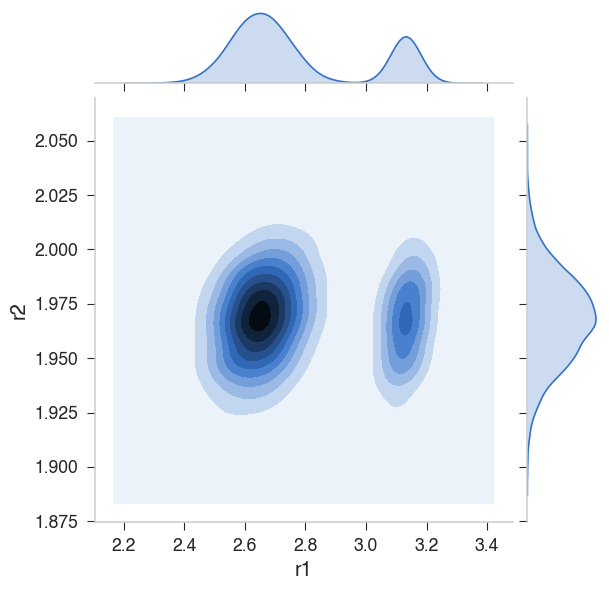

In [22]:

sns.jointplot("r1", "r2", kind="kde", data=a_data)


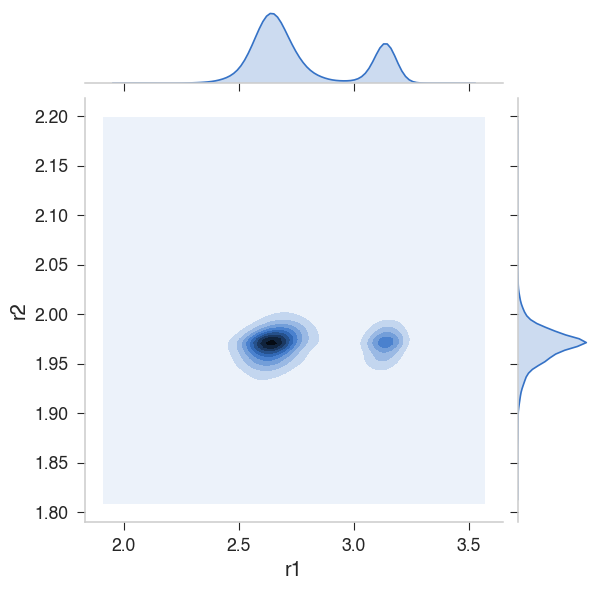

In [21]:
# data_res = data.query("ResName == 'TYR'").reset_index(drop=True)
sns.jointplot("r1", "r2", kind="kde", data=data_res)
# plt.show()

In [23]:
res = "VAL"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

VAL (5386, 7)


In [24]:
res = "THR"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

THR (4554, 7)


In [25]:
res = "LEU"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

LEU (9908, 7)


In [26]:
gmm, means, precisions_chol, weights = get_parameters(data_res[["r1", "r2", "r3"]].values)

a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
fig = px.scatter_3d(a_data, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

[[3.81631368 2.62699365 3.25635857]
 [3.28960405 2.62228722 3.84468189]
 [3.40400321 2.54777523 3.48161461]] [[[ 21.56443665 -20.31087137  29.53577717]
  [  0.          31.82002592 -31.54440303]
  [  0.           0.          15.20647733]]

 [[ 10.50375993  -5.88041783  14.66656477]
  [  0.          28.24665106 -41.98800848]
  [  0.           0.          39.58501182]]

 [[  3.39863001  -1.17747488   2.44047038]
  [  0.           7.63597718  -3.05495644]
  [  0.           0.           4.13307401]]] [0.27382855 0.61120681 0.11496464]


In [151]:
res = "ASP"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

ASP (5043, 7)
